# Tetons, WY, ROI#2

## Load *Streamlines* package

In [1]:
import streamlines

## Initiate *Streamlines* workflow

Choose the JSON parameters file we want to work with. The extension `.json` is automatically added.

In [2]:
JSON_parameters_file = 'Tetons_ROI2'

Initialize streamline analysis.

In [3]:
sl = streamlines.run( parameters_file=JSON_parameters_file, \
                        do_geodata = False, \
                        do_preprocess = False, \
                        do_condition=True, \
                        do_trace = False, \
                        do_analysis=False, \
                        do_mapping=False, \
                        do_plot=False, \
                        do_display=True, \
                        do_save=False )


Wed 2018-12-12 11:14:16 JST+0900

**Initialization begin**
Loaded JSON parameters file "/Users/colinstark/Work/Streamlines/slm_app1/Tetons_ROI2.json"
slm git:
[['commit dbf45629cc353bee2a227521b7fe6160b41c5ee6',
  'Author: Colin Stark',
  'Date:   Thu Sep 27 17:39:02 2018 +0900',
  '    Update nb, pdf']]
**Initialization end**



## Import DTM

In [4]:
sl.geodata.do()


**Geodata begin**
/Users/colinstark/Work/Streamlines/slm_app1
/Users/colinstark/Work/Streamlines/slm_data1 Tetons ROI2
Reading DTM from GeoTIFF file "/Users/colinstark/Work/Streamlines/slm_data1/Tetons/ROI2/Tetons_ROI2_res3m_fillsinks0p2.tif"
(508910.0, 3.0, 0.0, 4871395.0, 0.0, -3.0)
DTM size: 4504 x 3825 = 17,227,800 pixels
DTM pixel size: 3.0m
DTM origin:
  - bottom-left pixel center: [508910.00mE, 4859920.00mN]
  - bottom-left pixel corner: [508908.50mE, 4859918.50mN]


ERROR 1: NUMPY driver was compiled against GDAL 2.2, but the current library version is 2.3


ROI pixel bounds:  [[0, 4503], [0, 3824]]
ROI pixel grid:  4504 x 3825 = 17,227,800 pixels
ROI pixel-edge boundaries (assuming pixel-as-area)
  - in pixel units: [x: 0.0<=>4504.0] , [y: 0.0<=>3825.0]
  - in meters:      [x: 0.0<=>13512.0] , [y: 0.0<=>11475.0]
Reading basins from GeoTIFF file "/Users/colinstark/Work/Streamlines/slm_data1/Tetons/ROI2/Tetons_ROI2_res3m_fillsinks0p2_basins.tif"
(508910.0, 3.0, 0.0, 4871395.0, 0.0, -3.0)
Mask out all but basin numbers [590]
**Geodata end**



Recording figure "roi_shaded_relief"


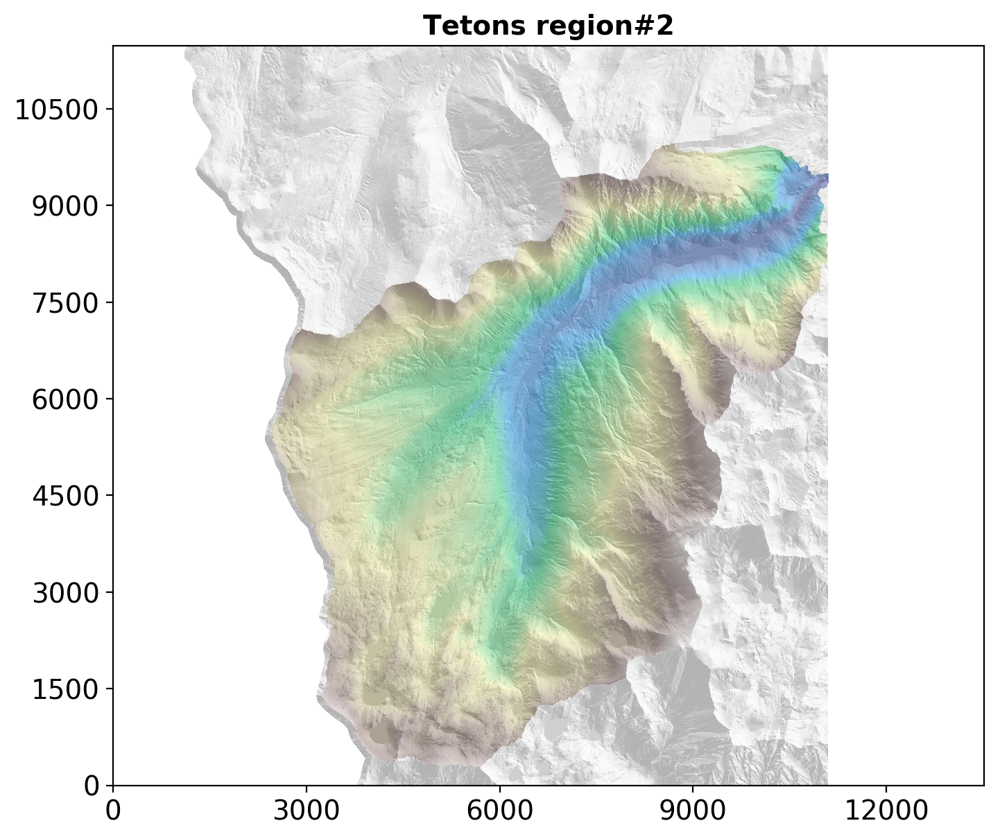

In [5]:
sl.plot.plot_roi_shaded_relief(interp_method='none')

## Preprocess DTM (fix loops etc)

In [6]:
%time sl.preprocess.do()


**Preprocess begin**
Precondition gradient vector field by fixing loops & blockages
Finding blockages...found 23141...done
Finding and fixing loops...
...done
Fixing blockages...
...done
Mask out bad uv pixels...done
**Preprocess end**

CPU times: user 58.9 s, sys: 1.69 s, total: 1min
Wall time: 1min


## Trace streamlines

In [7]:
%autosave 0
%time sl.trace.do()
%autosave 120

Autosave disabled

**Trace begin**
Integrating trajectories...
Generating seed points...shuffling...padding for 32 CL work items/group: 1000->1024...done
GPU/OpenCL device global memory limit for streamline trajectories: 3.6GB
GPU/OpenCL device memory required for streamline trajectories: 4MB => no need to chunkify
Total number of kernel instances: 1,024
Number of chunks = seed point array divisor: 1
Chunk size = number of kernel instances per chunk: 1,024
Downstream: downup=0 sgn(uv)=+1.0 chunk=0 seeds: 0+1000 => 1000
Seed point buffer size = 1000.0*8 bytes
0.0% 62.5% 100.0% 
Upstream:   downup=1 sgn(uv)=-1.0 chunk=0 seeds: 0+1000 => 1000
Seed point buffer size = 1000.0*8 bytes
0.0% 62.5% 100.0% 
Building streamlines compressed array
Streamlines actual array allocation:  size=1MB
Computing streamlines statistics
   downstream                           upstream                         
          min        mean          max       min        mean          max
l    1.588266  995.365784  

Autosaving every 120 seconds


In [8]:
import pandas as pd
ddf=pd.DataFrame(sl.trace.traj_stats_df.loc['downstream'].T)
udf=pd.DataFrame(sl.trace.traj_stats_df.loc['upstream'].T)
ddf.style.format("{:.3g}").set_properties(**{'font-size':'140%'})\
    .set_caption('Downstreamline statistics:')
udf.style.format("{:.3g}").set_properties(**{'font-size':'140%'})\
    .set_caption('Upstreamline statistics:')

,min,mean,max
l,1.59,995,1e+03
n,2,720,730
ds,0.794,1.38,1.4


,min,mean,max
l,2.8,831,1e+03
n,2,721,2e+03
ds,0.0679,1.29,1.59


Autosave disabled
Plotting all 1,000 down streamlines
Progress: 1%...2%...3%...4%...5%...6%...7%...8%...9%...10%...11%...12%...13%...14%...15%...16%...17%...18%...19%...20%...21%...22%...23%...24%...25%...26%...27%...28%...29%...30%...31%...32%...33%...34%...35%...36%...37%...38%...39%...40%...41%...42%...43%...44%...45%...46%...47%...48%...49%...50%...51%...52%...53%...54%...55%...56%...57%...58%...59%...60%...61%...62%...63%...64%...65%...66%...67%...68%...69%...70%...71%...72%...73%...74%...75%...76%...77%...78%...79%...80%...81%...82%...83%...84%...85%...86%...87%...88%...89%...90%...91%...92%...93%...94%...95%...96%...97%...98%...99%...100%
Plotting all 1,000 up streamlines
Progress: 1%...2%...3%...4%...5%...6%...7%...8%...9%...10%...11%...12%...13%...14%...15%...16%...17%...18%...19%...20%...21%...22%...23%...24%...25%...26%...27%...28%...29%...30%...31%...32%...33%...34%...35%...36%...37%...38%...39%...40%...41%...42%...43%...44%...45%...46%...47%...48%...49%...50%...51%...52%..

Autosaving every 120 seconds


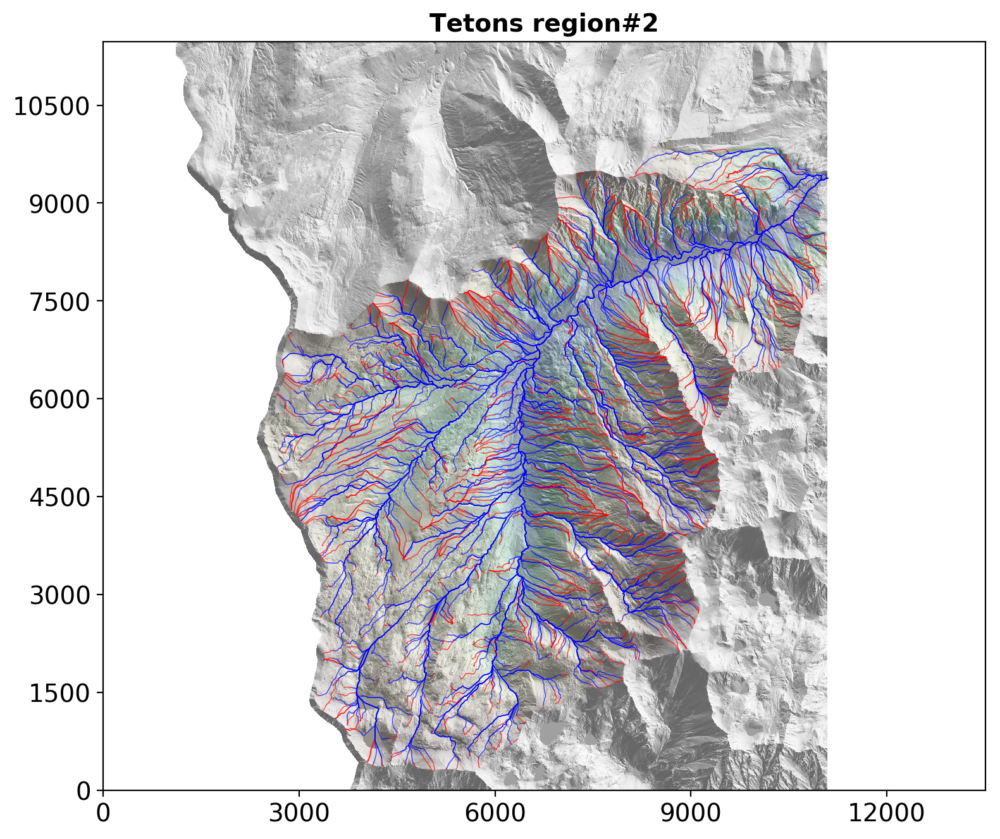

In [9]:
%autosave 0
sl.plot.plot_streamlines(window_size_factor=3)
%autosave 120

## Viz streamline flow concentrations

Recording figure "dsla"
Recording figure "dslt"


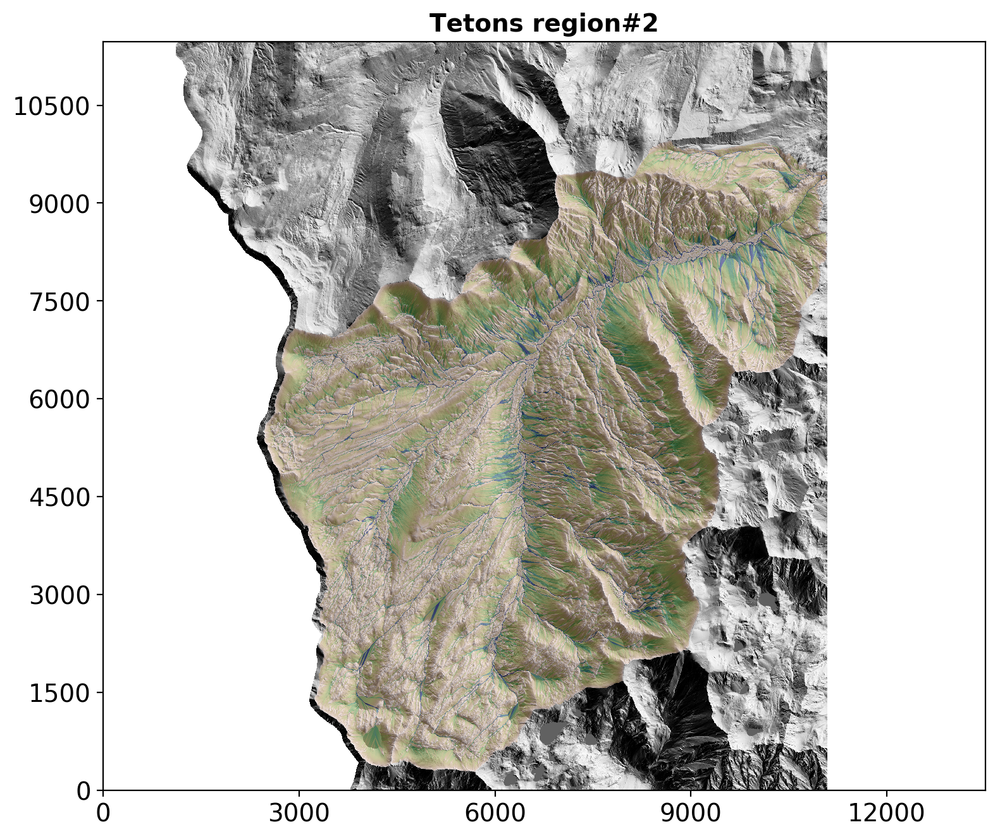

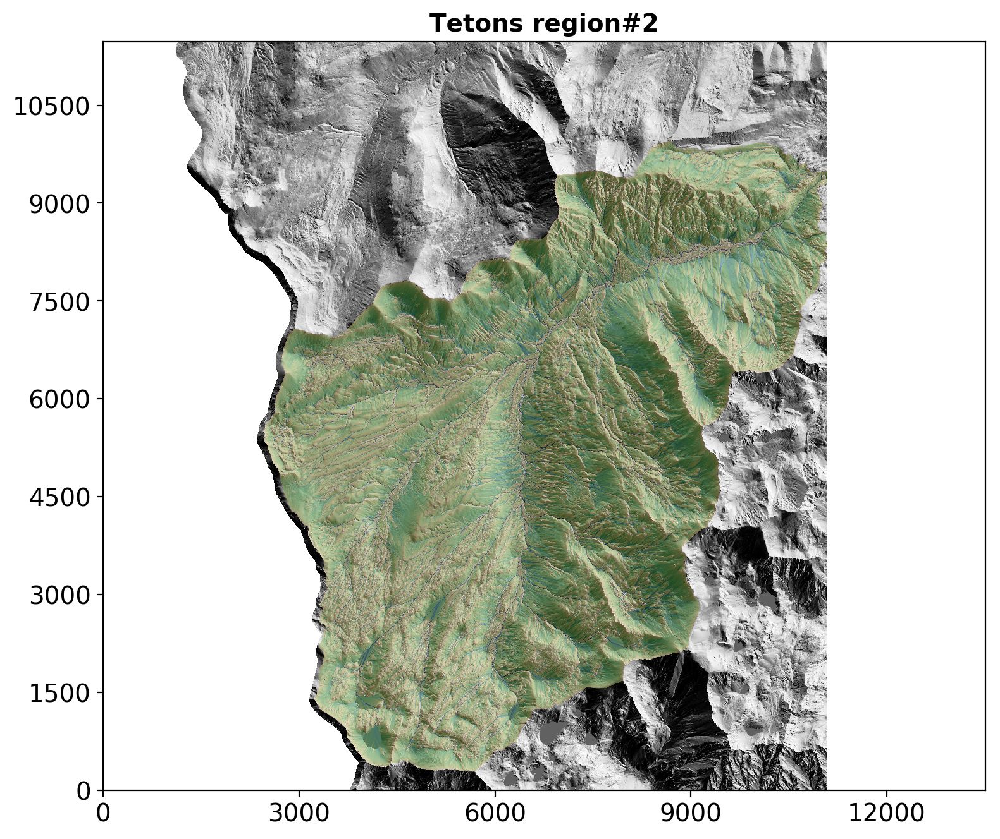

In [10]:
sl.plot.plot_flow_maps(window_size_factor=3)

## Analyze streamline distributions

In [11]:
# sl.analysis.do()

In [12]:
# sl.plot.plot_distributions()

## Map channels, segments & hillslope lengths

In [13]:
sl.analysis.search_cdf_min=0.9
sl.analysis.search_cdf_max=1

In [14]:
sl.mapping.pass1()


**Pass#1 begin**
Channels...done
Connecting channel pixels...
...done
Thinning channels...skeletonizing...done
Mapping channel heads...
...done
Counting down channels...
...done
Flagging down channels...
...done
Labeling confluences...
...done
Flagging down channels...
...done
Flagging down channels...
...done
Flagging down channels...
...done
Segmenting channels...number of segments=406
...done
Linking hillslopes...
...done
Segmenting hillslopes...
...done
Subsegmenting left & right flanks...number of subsegments=811
...done
Prepare for mapping HSL from midslopes
Midslopes...done
Ridges...done
**Pass#1 end**


In [15]:
sl.mapping.pass2()


**Pass#2 begin**
0.0% -406 
Channel threshold = 150.0m
FMM mean HSL   = 18.0m
Trace mean HSL = 18.0m
0.1% -405 
Channel threshold = 94.7m
FMM mean HSL   = 65.7m
Trace mean HSL = 95.3m
0.2% -404 
Channel threshold = 150.0m
FMM mean HSL   = 118.0m
Trace mean HSL = 176.2m
0.4% -403 
Channel threshold = 132.5m
FMM mean HSL   = 109.6m
Trace mean HSL = 159.6m
0.5% -402 
Channel threshold = 239.0m
FMM mean HSL   = 103.3m
Trace mean HSL = 156.4m
0.6% -401 
Channel threshold = 136.2m
FMM mean HSL   = 125.6m
Trace mean HSL = 184.0m
0.7% -400 
Channel threshold = 150.0m
FMM mean HSL   = 110.8m
Trace mean HSL = 154.3m
0.9% -399 
Channel threshold = 143.8m
FMM mean HSL   = 102.9m
Trace mean HSL = 145.8m
1.0% -398 
Channel threshold = 314.1m
FMM mean HSL   = 125.2m
Trace mean HSL = 164.4m
1.1% -397 
Channel threshold = 150.0m
FMM mean HSL   = 49.3m
Trace mean HSL = 118.2m
1.2% -396 
Channel threshold = 150.0m
FMM mean HSL   = 116.8m
Trace mean HSL = 180.8m
1.4% -395 
Channel threshold = 150.0m
FMM 

FMM mean HSL   = 74.4m
Trace mean HSL = 180.8m
12.1% -308 
Channel threshold = 726.4m
FMM mean HSL   = 91.8m
Trace mean HSL = 562.0m
12.2% -307 
Channel threshold = 205.2m
FMM mean HSL   = 75.9m
Trace mean HSL = 148.3m
12.3% -306 
Channel threshold = 150.0m
FMM mean HSL   = 66.4m
Trace mean HSL = 160.9m
12.5% -305 
Channel threshold = 260.6m
FMM mean HSL   = 75.4m
Trace mean HSL = 184.6m
12.6% -304 
Channel threshold = 189.2m
FMM mean HSL   = 113.1m
Trace mean HSL = 214.8m
12.7% -303 
Channel threshold = 412.5m
FMM mean HSL   = 125.8m
Trace mean HSL = 265.4m
12.8% -302 
Channel threshold = 193.9m
FMM mean HSL   = 113.1m
Trace mean HSL = 224.4m
13.0% -301 
Channel threshold = 150.0m
FMM mean HSL   = 65.6m
Trace mean HSL = 97.8m
13.1% -300 
Channel threshold = 139.7m
FMM mean HSL   = 110.2m
Trace mean HSL = 180.1m
13.2% -299 
Channel threshold = 150.0m
FMM mean HSL   = 80.7m
Trace mean HSL = 161.3m
13.3% -298 
Channel threshold = 150.0m
FMM mean HSL   = 80.1m
Trace mean HSL = 135.7m
13.5

24.0% -212 
Channel threshold = 150.0m
FMM mean HSL   = 11.0m
Trace mean HSL = 9.5m
24.1% -211 
Channel threshold = 975.4m
FMM mean HSL   = 544.0m
Trace mean HSL = 595.1m
24.2% -210 
Channel threshold = 150.0m
FMM mean HSL   = 55.9m
Trace mean HSL = 104.6m
24.3% -209 
Channel threshold = 659.9m
FMM mean HSL   = 244.9m
Trace mean HSL = 567.6m
24.4% -208 
Channel threshold = 150.0m
FMM mean HSL   = 64.2m
Trace mean HSL = 126.3m
24.6% -207 
Channel threshold = 150.0m
FMM mean HSL   = 63.0m
Trace mean HSL = 102.6m
24.7% -206 
Channel threshold = 300.6m
FMM mean HSL   = 151.8m
Trace mean HSL = 262.6m
24.8% -205 
Channel threshold = 281.7m
FMM mean HSL   = 134.2m
Trace mean HSL = 323.0m
24.9% -204 
Channel threshold = 133.3m
FMM mean HSL   = 62.8m
Trace mean HSL = 117.4m
25.1% -203 
Channel threshold = 150.0m
FMM mean HSL   = 36.0m
Trace mean HSL = 33.6m
25.2% -202 
Channel threshold = 160.8m
FMM mean HSL   = 108.0m
Trace mean HSL = 192.0m
25.3% -201 
Channel threshold = 150.0m
FMM mean HSL 

Trace mean HSL = 112.7m
35.8% -115 
Channel threshold = 150.0m
FMM mean HSL   = 71.8m
Trace mean HSL = 113.9m
35.9% -114 
Channel threshold = 82.5m
FMM mean HSL   = 66.1m
Trace mean HSL = 92.2m
36.0% -113 
Channel threshold = 150.0m
FMM mean HSL   = 93.7m
Trace mean HSL = 181.3m
36.2% -112 
Channel threshold = 150.0m
FMM mean HSL   = 75.0m
Trace mean HSL = 106.7m
36.3% -111 
Channel threshold = 238.1m
FMM mean HSL   = 82.2m
Trace mean HSL = 175.0m
36.4% -110 
Channel threshold = 131.4m
FMM mean HSL   = 77.1m
Trace mean HSL = 136.0m
36.5% -109 
Channel threshold = 150.0m
FMM mean HSL   = 63.3m
Trace mean HSL = 107.7m
36.7% -108 
Channel threshold = 124.3m
FMM mean HSL   = 69.9m
Trace mean HSL = 118.3m
36.8% -107 
Channel threshold = 102.5m
FMM mean HSL   = 79.0m
Trace mean HSL = 106.3m
36.9% -106 
Channel threshold = 234.3m
FMM mean HSL   = 125.7m
Trace mean HSL = 165.5m
37.0% -105 
Channel threshold = 183.0m
FMM mean HSL   = 87.8m
Trace mean HSL = 145.8m
37.2% -104 
Channel threshold =

Trace mean HSL = 82.0m
47.8% -17 
Channel threshold = 194.1m
FMM mean HSL   = 138.6m
Trace mean HSL = 198.7m
47.9% -16 
Channel threshold = 150.0m
FMM mean HSL   = 54.1m
Trace mean HSL = 88.3m
48.0% -15 
Channel threshold = 160.7m
FMM mean HSL   = 92.5m
Trace mean HSL = 151.4m
48.1% -14 
Channel threshold = 174.2m
FMM mean HSL   = 101.7m
Trace mean HSL = 169.5m
48.3% -13 
Channel threshold = 147.1m
FMM mean HSL   = 94.2m
Trace mean HSL = 166.7m
48.4% -12 
Channel threshold = 256.5m
FMM mean HSL   = 107.1m
Trace mean HSL = 196.9m
48.5% -11 
Channel threshold = 200.6m
FMM mean HSL   = 143.7m
Trace mean HSL = 216.6m
48.6% -10 
Channel threshold = 71.9m
FMM mean HSL   = 76.1m
Trace mean HSL = 94.0m
48.8% -9 
Channel threshold = 154.3m
FMM mean HSL   = 93.8m
Trace mean HSL = 178.3m
48.9% -8 
Channel threshold = 150.0m
FMM mean HSL   = 63.7m
Trace mean HSL = 95.2m
49.0% -7 
Channel threshold = 247.5m
FMM mean HSL   = 77.9m
Trace mean HSL = 174.5m
49.1% -6 
Channel threshold = 245.3m
FMM mean

60.0% +83 
Channel threshold = 150.0m
FMM mean HSL   = 28.8m
Trace mean HSL = 34.9m
60.1% +84 
Channel threshold = 150.0m
FMM mean HSL   = 67.7m
Trace mean HSL = 121.5m
60.2% +85 
Channel threshold = 241.0m
FMM mean HSL   = 95.3m
Trace mean HSL = 180.3m
60.4% +86 
Channel threshold = 384.1m
FMM mean HSL   = 92.4m
Trace mean HSL = 254.7m
60.5% +87 
Channel threshold = 323.9m
FMM mean HSL   = 71.0m
Trace mean HSL = 110.7m
60.6% +88 
Channel threshold = 353.4m
FMM mean HSL   = 105.1m
Trace mean HSL = 216.9m
60.7% +89 
Channel threshold = 150.0m
FMM mean HSL   = 50.5m
Trace mean HSL = 85.5m
60.9% +90 
Channel threshold = 150.0m
FMM mean HSL   = 53.0m
Trace mean HSL = 77.7m
61.0% +91 
Channel threshold = 150.0m
FMM mean HSL   = 25.2m
Trace mean HSL = 29.0m
61.1% +92 
Channel threshold = 150.0m
FMM mean HSL   = 34.0m
Trace mean HSL = 49.8m
61.2% +93 
Channel threshold = 150.0m
FMM mean HSL   = 61.6m
Trace mean HSL = 101.9m
61.4% +94 
Channel threshold = 94.9m
FMM mean HSL   = 58.4m
Trace mea

72.3% +183 
Channel threshold = 150.0m
FMM mean HSL   = 18.0m
Trace mean HSL = 18.0m
72.5% +184 
Channel threshold = 150.0m
FMM mean HSL   = 22.5m
Trace mean HSL = 37.8m
72.6% +185 
Channel threshold = 150.0m
FMM mean HSL   = 23.0m
Trace mean HSL = 23.0m
72.7% +186 
Channel threshold = 150.0m
FMM mean HSL   = 16.0m
Trace mean HSL = 16.0m
72.8% +187 
Channel threshold = 150.0m
FMM mean HSL   = 62.8m
Trace mean HSL = 79.8m
73.0% +188 
Channel threshold = 394.5m
FMM mean HSL   = 83.6m
Trace mean HSL = 190.7m
73.1% +189 
Channel threshold = 150.0m
FMM mean HSL   = 31.6m
Trace mean HSL = 36.7m
73.2% +190 
Channel threshold = 262.0m
FMM mean HSL   = 46.0m
Trace mean HSL = 91.5m
73.3% +191    --- (problem measuring HSL using FM)
73.5% +192 
Channel threshold = 150.0m
FMM mean HSL   = 53.3m
Trace mean HSL = 79.5m
73.6% +193 
Channel threshold = 150.0m
FMM mean HSL   = 15.7m
Trace mean HSL = 24.1m
73.7% +194 
Channel threshold = 150.0m
FMM mean HSL   = 13.0m
Trace mean HSL = 13.1m
73.8% +195 
C

FMM mean HSL   = 38.4m
Trace mean HSL = 77.2m
84.3% +280 
Channel threshold = 104.9m
FMM mean HSL   = 88.0m
Trace mean HSL = 196.2m
84.4% +281 
Channel threshold = 150.0m
FMM mean HSL   = 24.5m
Trace mean HSL = 32.3m
84.6% +282 
Channel threshold = 150.0m
FMM mean HSL   = 8.0m
Trace mean HSL = 8.0m
84.7% +283 
Channel threshold = 79.8m
FMM mean HSL   = 46.7m
Trace mean HSL = 64.1m
84.8% +284    --- (problem measuring HSL using FM)
84.9% +285 
Channel threshold = 619.2m
FMM mean HSL   = 163.8m
Trace mean HSL = 230.0m
85.1% +286 
Channel threshold = 150.0m
FMM mean HSL   = 20.0m
Trace mean HSL = 19.8m
85.2% +287 
Channel threshold = 518.5m
FMM mean HSL   = 174.2m
Trace mean HSL = 387.1m
85.3% +288 
Channel threshold = 150.0m
FMM mean HSL   = 80.0m
Trace mean HSL = 80.0m
85.4% +289 
Channel threshold = 150.0m
FMM mean HSL   = 6.0m
Trace mean HSL = 6.0m
85.6% +290 
Channel threshold = 553.8m
FMM mean HSL   = 187.5m
Trace mean HSL = 519.8m
85.7% +291 
Channel threshold = 150.0m
FMM mean HSL

FMM mean HSL   = 99.7m
Trace mean HSL = 166.7m
96.3% +377 
Channel threshold = 150.0m
FMM mean HSL   = 101.0m
Trace mean HSL = 134.8m
96.4% +378 
Channel threshold = 150.0m
FMM mean HSL   = 29.3m
Trace mean HSL = 28.8m
96.5% +379 
Channel threshold = 150.0m
FMM mean HSL   = 41.4m
Trace mean HSL = 51.0m
96.7% +380 
Channel threshold = 152.1m
FMM mean HSL   = 81.2m
Trace mean HSL = 144.8m
96.8% +381    --- (problem measuring HSL using FM)
96.9% +382 
Channel threshold = 150.0m
FMM mean HSL   = 29.5m
Trace mean HSL = 33.5m
97.0% +383    --- (problem measuring HSL using FM)
97.2% +384 
Channel threshold = 150.0m
FMM mean HSL   = 13.0m
Trace mean HSL = 13.2m
97.3% +385 
Channel threshold = 150.0m
FMM mean HSL   = 52.3m
Trace mean HSL = 78.3m
97.4% +386 
Channel threshold = 150.0m
FMM mean HSL   = 24.9m
Trace mean HSL = 28.2m
97.5% +387 
Channel threshold = 233.1m
FMM mean HSL   = 145.0m
Trace mean HSL = 145.0m
97.7% +388 
Channel threshold = 150.0m
FMM mean HSL   = 13.0m
Trace mean HSL = 13

In [16]:
sl.mapping.pass3()


**Pass#3 begin**
Connecting channel pixels...
...done
Thinning channels...skeletonizing...done
Mapping channel heads...
...done
Counting down channels...
...done
Flagging down channels...
...done
Mapping hillslope lengths from midslopes...dilation with 51m (17-pixel) width filter...mean filtering with 60m (20-pixel) diameter disk...done
Computing hillslope aspect with median filter radii 4m (slope), 50m (uv)...done
Computing hillslope length-aspect function...done
Computing hillslope length-aspect statistics...done
**Pass#3 end**


## Viz channels & segments

Recording figure "channels"
Recording figure "label"


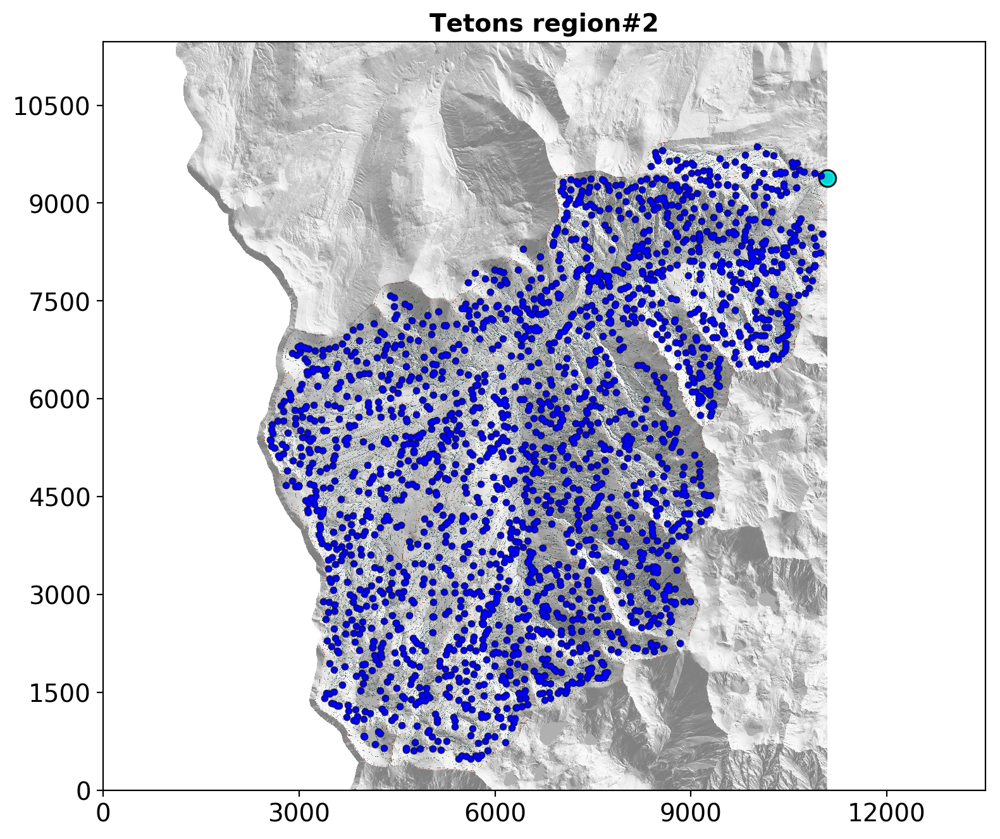

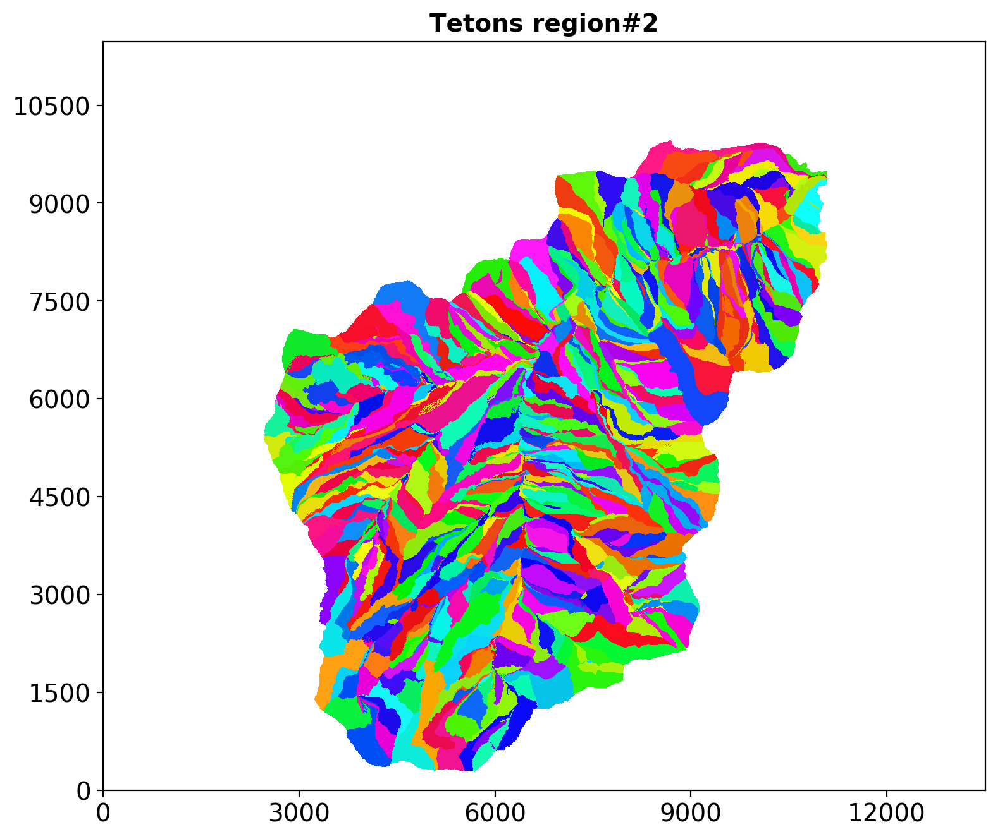

In [17]:
sl.plot.plot_channels(window_size_factor=3)
sl.plot.plot_segments(window_size_factor=3)

## Viz hillslope lengths

Recording figure "hsl"


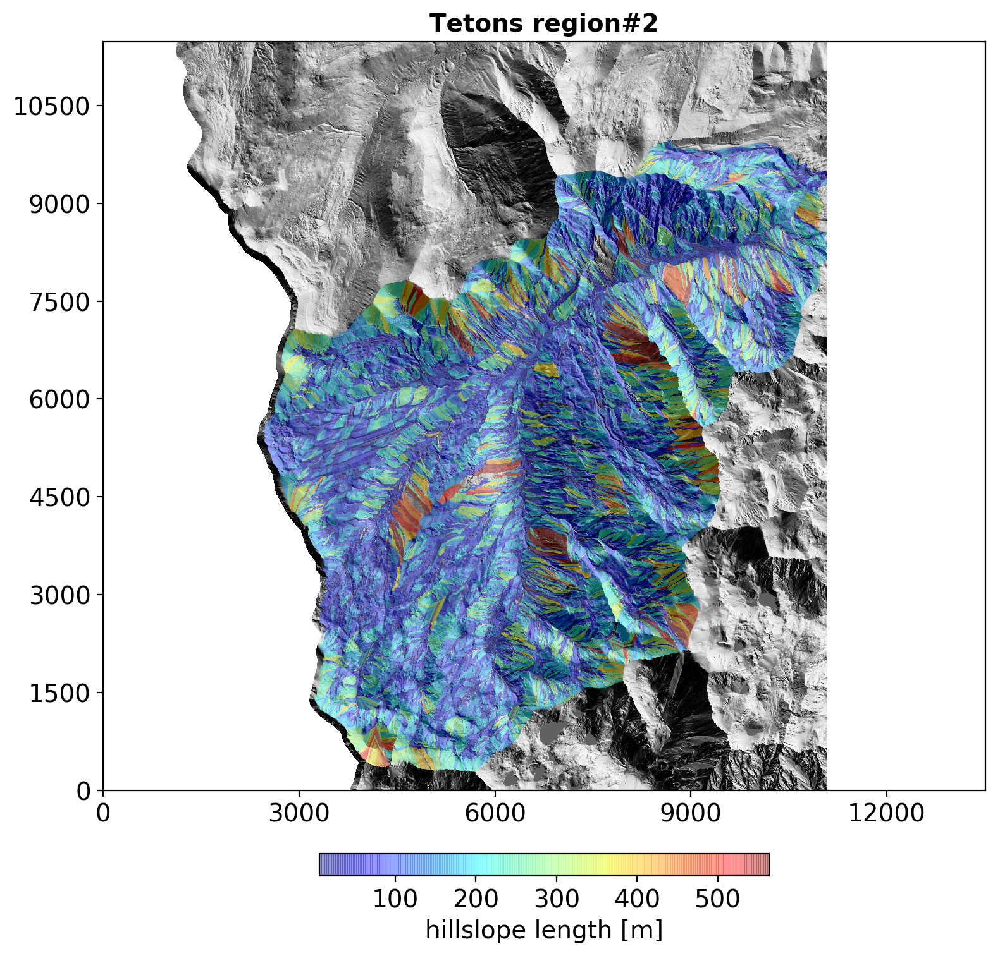

In [18]:
sl.plot.plot_hsl(window_size_factor=3)

Recording figure "hsl_contours"


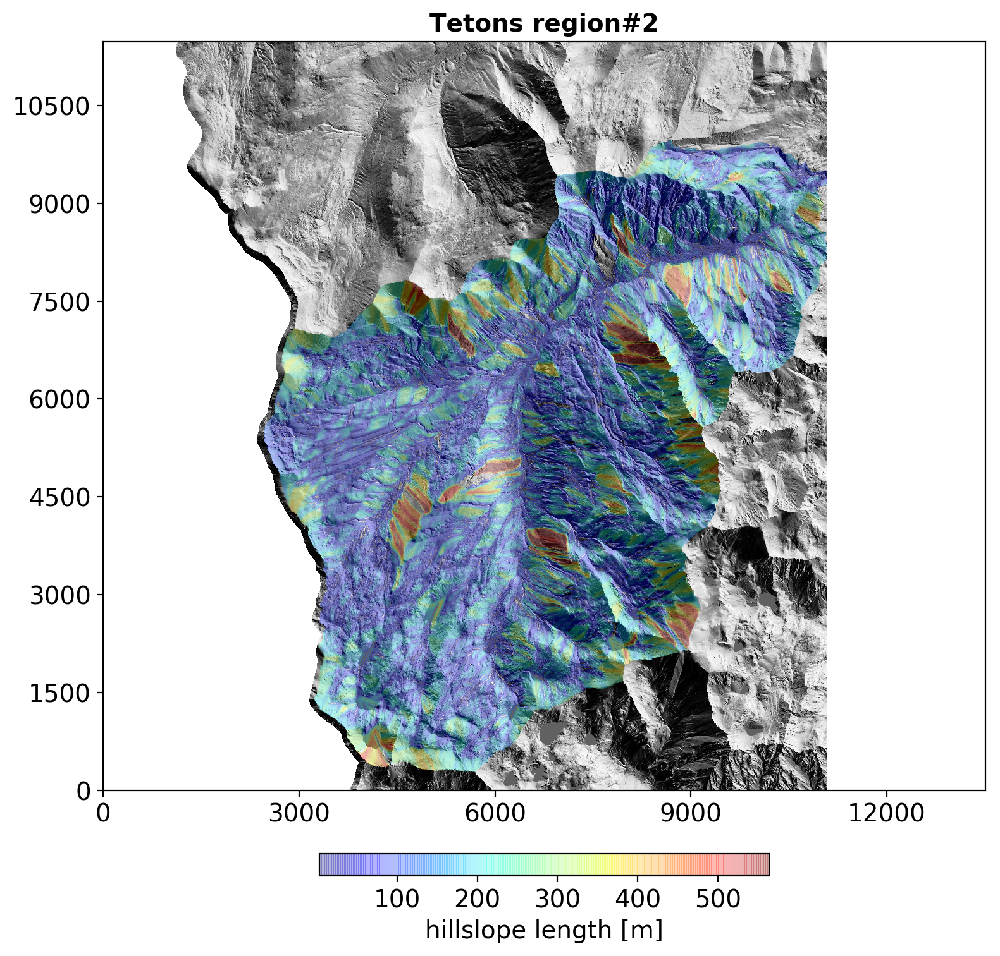

In [19]:
sl.plot.plot_hsl_contoured(window_size_factor=3)

## Viz aspect, hillslope length

Recording figure "aspect"


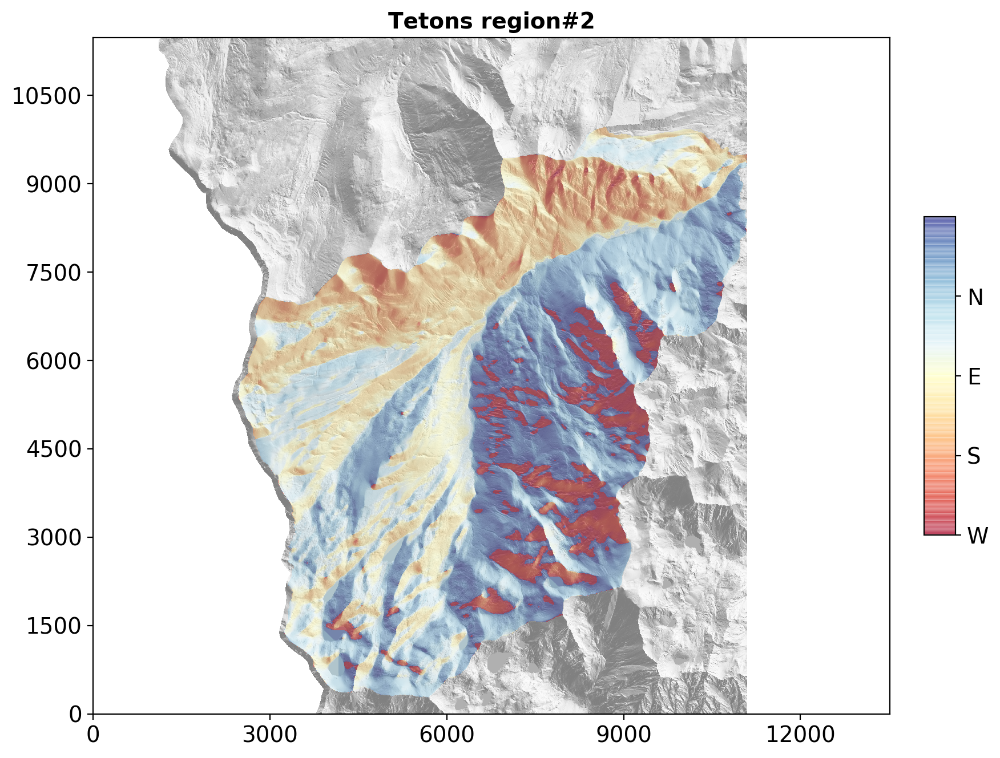

In [20]:
sl.plot.plot_aspect(window_size_factor=3.25)

In [21]:
sl.mapping.check_hsl_ns_disparity()

HSL mean ± σ(split), σ(all):	      170.8m ± 15.1m (split) 21.4m (all)
HSL N-S disparity:		      165.4mN vs 175.9mS   ∆≈10.5m
HSL N-S rel disparity vs variation:   6.1% (10.5m) NS vs 8.9% (15.1m)
HSL N-S disparity signal-noise ratio: ∆/σ = 0.7
					=> weak south bias
N-facing vs S-facing HSL distribution comparison tests
  for f(HSL_N,S) with N,S bounds 45°<|±aspect|<135° from east
D_alpha =  c(alpha)*0.00700938
Kolmogorov-Smirnov: 0.04 p=9.07077e-32
Mann-Whitney:       0.48 p=2.18304e-20
Rank-sum:           9.2 p=4.36607e-20
Student's t:        6.5 p=6.37162e-11
Welch:              6.5 p=6.6376e-11
P-P:                -12%


Recording figure "hsl_aspect_distribution"


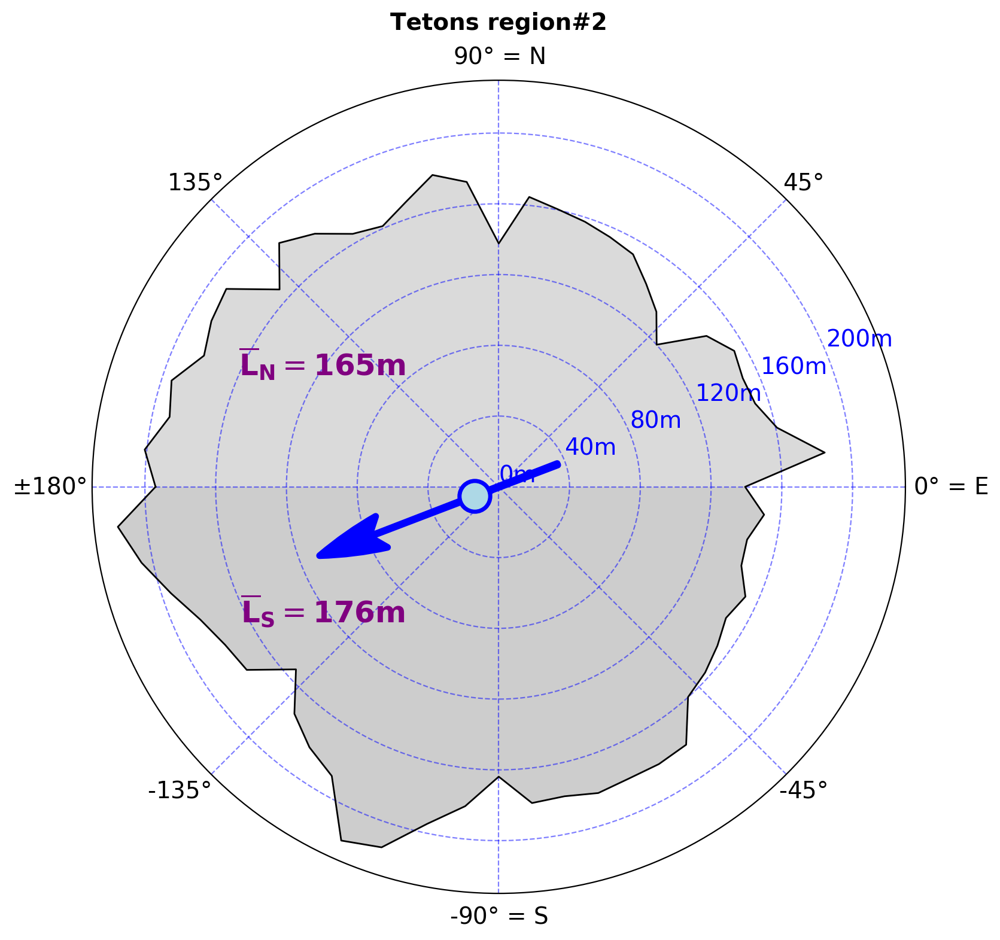

In [22]:
sl.plot.plot_hsl_aspect_distribution(window_size_factor=3)

## Hillslope length stats

Plotting hillslope length distributions...
Recording figure "hsl_nsall_distbn"
Recording figure "hsl_ns_qq"
Recording figure "hsl_ns_pp"


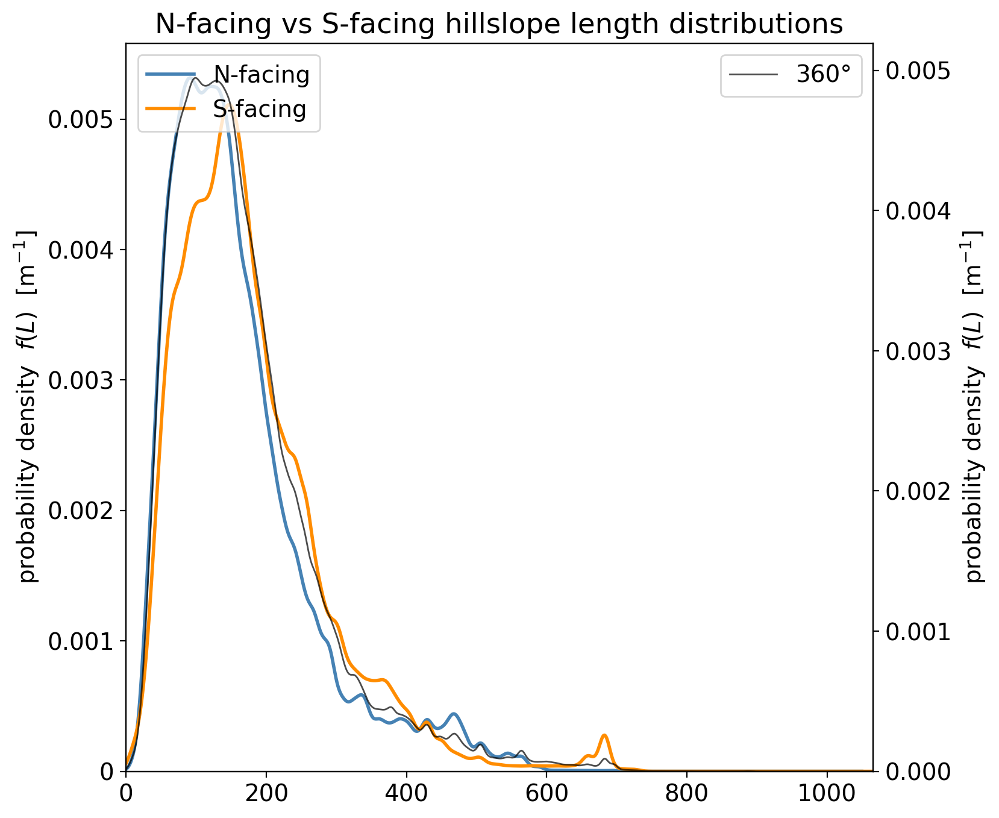

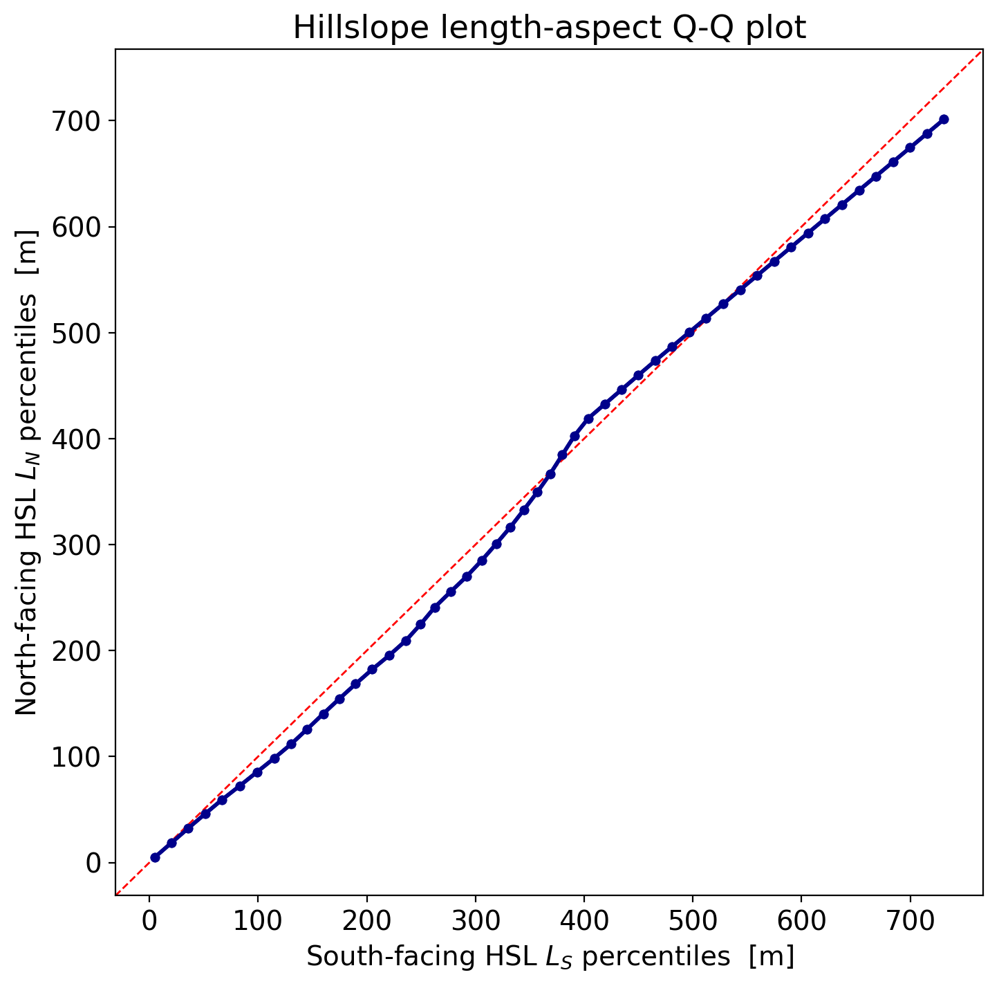

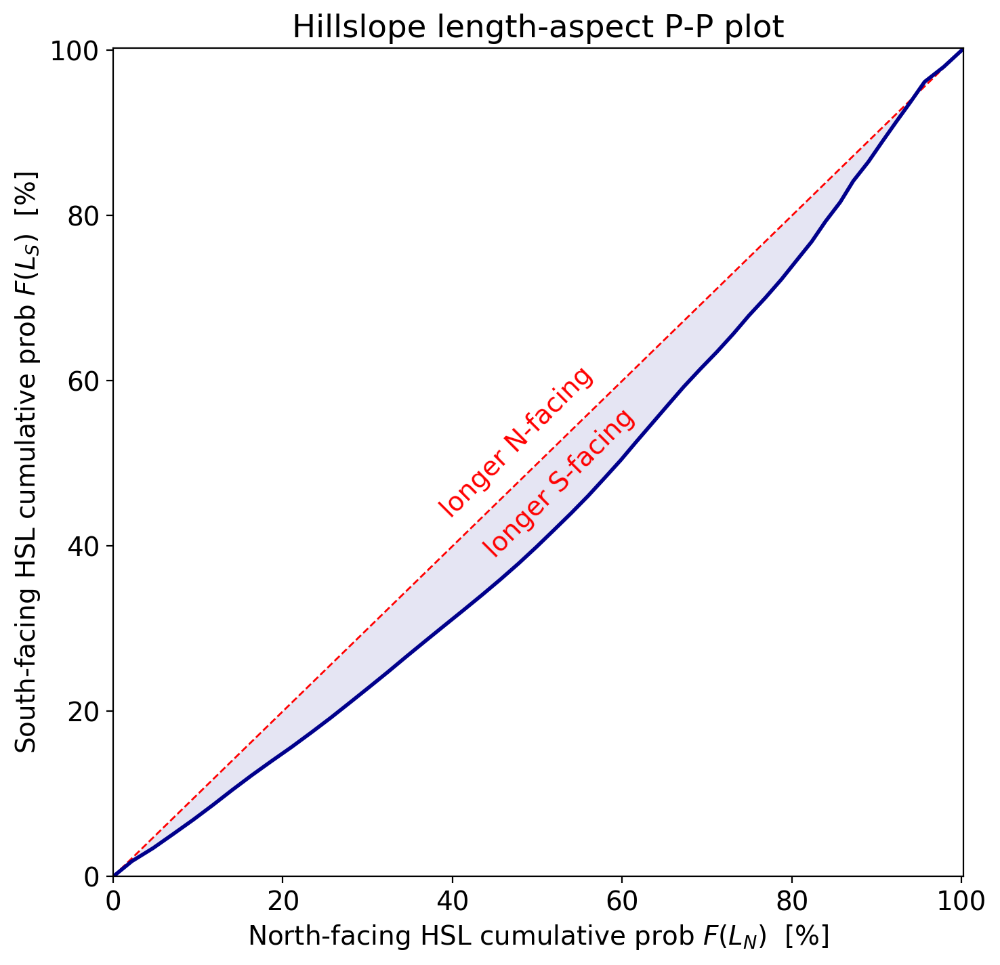

In [23]:
sl.plot.plot_hsl_distributions()

In [24]:
df = sl.mapping.hsl_stats_df
df[:30].style.format("{:.3g}").set_properties(**{'font-size':'140%'}) \
         .set_caption('Hillslope length statistics:')
df.mean()

,,count,mean [m],stddev [m]
fine,coarse,,,


count        NaN
mean [m]     NaN
stddev [m]   NaN
dtype: float64

## Export plots

In [25]:
sl.plot.figs

{'roi_shaded_relief': <Figure size 810x810 with 1 Axes>,
 'streamlines': <Figure size 900x900 with 1 Axes>,
 'dsla': <Figure size 900x900 with 1 Axes>,
 'dslt': <Figure size 900x900 with 1 Axes>,
 'channels': <Figure size 900x900 with 1 Axes>,
 'label': <Figure size 900x900 with 1 Axes>,
 'hsl': <Figure size 900x900 with 2 Axes>,
 'hsl_contours': <Figure size 900x900 with 2 Axes>,
 'aspect': <Figure size 975x975 with 2 Axes>,
 'hsl_aspect_distribution': <Figure size 900x900 with 1 Axes>,
 'hsl_nsall_distbn': <Figure size 800x800 with 2 Axes>,
 'hsl_ns_qq': <Figure size 810x810 with 1 Axes>,
 'hsl_ns_pp': <Figure size 810x810 with 1 Axes>}

In [26]:
sl.save.do()


**Write results to files begin**
Creating export directory "/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2"
Saving maps...
<class 'tuple'>
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_dtm_mask.tif (4508, 3829)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_basin_mask.tif (4508, 3829)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_uv.tif (4508, 3829, 2)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_slope.tif (4508, 3829)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_mapping.tif (4508, 3829)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_coarse_subsegment.tif (4508, 3829)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_merged_coarse_mask.tif (4508, 3829)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_hsl.tif (4508, 3829)
/Users/colinstark/Work/Streamlines/slm_app1/Tetons/ROI2/Tetons_ROI2_hsl_smoothed.tif (4508